In [1]:
import glob
import math
import matplotlib.pyplot as plt
import multiprocessing
import numpy as np
import openslide
from openslide import OpenSlideError
import os
import PIL
import cv2
from PIL import Image
import re
import sys
import time
from skimage.transform import resize
import random

from PIL import Image
Image.MAX_IMAGE_PIXELS = None

# Image functions
from PIL import Image
from scipy.ndimage.morphology import binary_fill_holes
from skimage.color import rgb2gray
from skimage.feature import canny
from skimage.morphology import binary_closing, binary_dilation, disk
from tqdm import tqdm
import shutil

SCALE_FACTOR = 1

### Parameters

In [2]:
# Parameters
sample_folder = 'Control/'
PATH = '/project/GutIntelligenceLab/msds/data/Cincinnati/unpatched/' + sample_folder

patch_size = 512
# resize_to = 512

# PATH FOR SAVING PATCHES - DON'T FORGET
target_path_unnorm = '/project/GutIntelligenceLab/msds/data/INOVA/patched1/' + sample_folder

thresh = 0.5
overlap = 0 # %-age area

In [3]:
print(PATH)

/project/GutIntelligenceLab/msds/data/Cincinnati/unpatched/Control/


### Function

In [4]:
# Utility FUnction
def open_slide(filename):
    """
    Open a whole-slide image (*.svs, etc).
    Args:
    filename: Name of the slide file.
    Returns:
    An OpenSlide object representing a whole-slide image.
    """
    try:
        slide = openslide.open_slide(filename)
    except OpenSlideError:
        slide = None
    except FileNotFoundError:
        slide = None
    return slide

def optical_density(tile):
    tile = tile.astype(np.float64)
    od = -np.log((tile+1)/240)
    return od

def keep_tile(tile_tuple, tile_size, tissue_threshold):
    """
    Use bunch of functions to identify if patch should be kept or not
    """
    slide_num, tile = tile_tuple
    if tile.shape[0:2] == (tile_size, tile_size):
        tile_orig = tile
        tile = rgb2gray(tile)
        tile = 1 - tile
        tile = canny(tile)
        tile = binary_closing(tile, disk(10))
        tile = binary_dilation(tile, disk(10))
        tile = binary_fill_holes(tile)
        percentage = tile.mean()
        check1 = percentage >= tissue_threshold

        tile = optical_density(tile_orig)
        beta = 0.15
        tile = np.min(tile, axis=2) >= beta
        tile = binary_closing(tile, disk(2))
        tile = binary_dilation(tile, disk(2))
        tile = binary_fill_holes(tile)
        percentage = tile.mean()
        check2 = percentage >= tissue_threshold

        return check1 and check2
    else:
        return False

In [5]:
# Using this for thresholding logic
def filter_grays(rgb, tolerance=15, output_type="bool"):
    """
    Create a mask to filter out pixels where the red, green, and blue channel values are similar.
    Args:
    np_img: RGB image as a NumPy array.
    tolerance: Tolerance value to determine how similar the values must be in order to be filtered out
    output_type: Type of array to return (bool, float, or uint8).
    Returns:
    NumPy array representing a mask where pixels with similar red, green, and blue values have been masked out.
    """
    rgb = rgb.astype(np.int)
    rg_diff = abs(rgb[:, :, 0] - rgb[:, :, 1]) <= tolerance
    rb_diff = abs(rgb[:, :, 0] - rgb[:, :, 2]) <= tolerance
    gb_diff = abs(rgb[:, :, 1] - rgb[:, :, 2]) <= tolerance
    result = ~(rg_diff & rb_diff & gb_diff)

    if output_type == "bool":
        pass
    elif output_type == "float":
        result = result.astype(float)
    else:
        result = result.astype("uint8") * 255
    return result

def find_boundary(o):
    """
    For removing white area
    """
    
    ws = o.read_region((0, 0), o.level_count-1, o.level_dimensions[o.level_count-1])
    ws = ws.convert('RGB')
    ws = np.asarray(ws)
    ws = filter_grays(ws)

    y_min = np.where(ws == 1)[0].min()
    x_min = np.where(ws == 1)[1].min()

    y_max = np.where(ws == 1)[0].max()
    x_max = np.where(ws == 1)[1].max()

    return x_min, x_max, y_min, y_max    

In [6]:
def patch_image(filename, level=0, patch_size = 512, rescale = False):
    """
    Patches the image and saves it in the TARGET PATH
    Args:
        filename: Path of file to patch
        level: Level to patch    
    """

    file = filename.split('/')[-1]
    print(file)
    
    # Read Image
    image = open_slide(filename)
    
    # If Rescaling Image
    if rescale == True:
        rescale = resize_to / patch_size
        new_dims = int(rescale * (image.dimensions[0] // resize_to) * resize_to) , \
        int(rescale * (image.dimensions[1] // resize_to) * resize_to)    
    
    # Hack to remove corner white area from the image
    x_min, x_max, y_min, y_max = find_boundary(image)
    
    # Initialize x and y coord
    x_cord = x_min*(image.level_downsamples[-1]/image.level_downsamples[level])
    y_cord = y_min*(image.level_downsamples[-1]/image.level_downsamples[level])    
    x_max = x_max*(image.level_downsamples[-1]/image.level_downsamples[level])
    y_max = y_max*(image.level_downsamples[-1]/image.level_downsamples[level])    

    # Reading smallest level image for quick white area check
    downsampled_img = image.read_region((0, 0), image.level_count-1, image.level_dimensions[-1])
    downsampled_img = downsampled_img.convert('RGB')
    downsampled_img = np.array(downsampled_img)    
    
    print('Estimated Patches: {}', ((y_max-y_min)*(x_max-x_min))/(512*512))
    counter = 0
    while x_cord + patch_size <= x_max: #image.dimensions[0]:

        # Quick Check for removing whole x-axis panel if no tissue present
        s = int(512/(image.level_downsamples[-1]/image.level_downsamples[level]))
        xds = int(x_cord*(image.level_downsamples[level]/image.level_downsamples[-1]))        
        if downsampled_img[:, xds:xds+s].min()>220:
            # Taking care of overlap
            x_cord = int(x_cord + (1 - overlap) * patch_size)
            y_cord = int(y_min*(image.level_downsamples[-1]/image.level_downsamples[level]))
            continue
        
        while y_cord + patch_size <= y_max: #image.dimensions[1]:
            
            # Quick Check for removing patch 
            yds = int(y_cord*(image.level_downsamples[level]/image.level_downsamples[-1]))
            if downsampled_img[yds:yds+s, xds:xds+s].min()>220:
                y_cord = int(y_cord + (1 - overlap) * patch_size)                
                continue

            counter += 1
            patch = image.read_region((int(x_cord*(image.level_downsamples[level]/image.level_downsamples[0])),\
                                       int(y_cord*(image.level_downsamples[level]/image.level_downsamples[0]))),\
                                       level, (patch_size, patch_size))
            patch = patch.convert('RGB')
            if resize == True:
                patch = patch.resize((resize_to, resize_to))
            patch = np.array(patch)
                        
            if keep_tile((0, patch), patch_size, thresh) == False:
                y_cord = int(y_cord + (1 - overlap) * patch_size)
                continue
                
            patch = Image.fromarray(patch)
            
            # Save unnormalized patch
            target_folder = target_path_unnorm
            if not os.path.exists(target_folder):
                os.mkdir(target_folder)
            filename = target_folder + file.split('.')[0] + '__' + str(x_cord) + '_' + str(y_cord) + '.jpg'
            patch.save(filename)

            # Taking care of overlap
            y_cord = int(y_cord + (1 - overlap) * patch_size)

        # Taking care of overlap
        x_cord = int(x_cord + (1 - overlap) * patch_size)
        y_cord = y_min*(image.level_downsamples[-1]/image.level_downsamples[level])

    print(filename + ' Complete!')

### Example

In [70]:
ind = random.randint(0, len(os.listdir(PATH)))
filename = PATH + os.listdir(PATH)[ind]
filename

'/project/GutIntelligenceLab/msds/data/Cincinnati/unpatched/Control/RK10366.ndpi'

In [71]:
os.listdir(PATH)[ind]

'RK10366.ndpi'

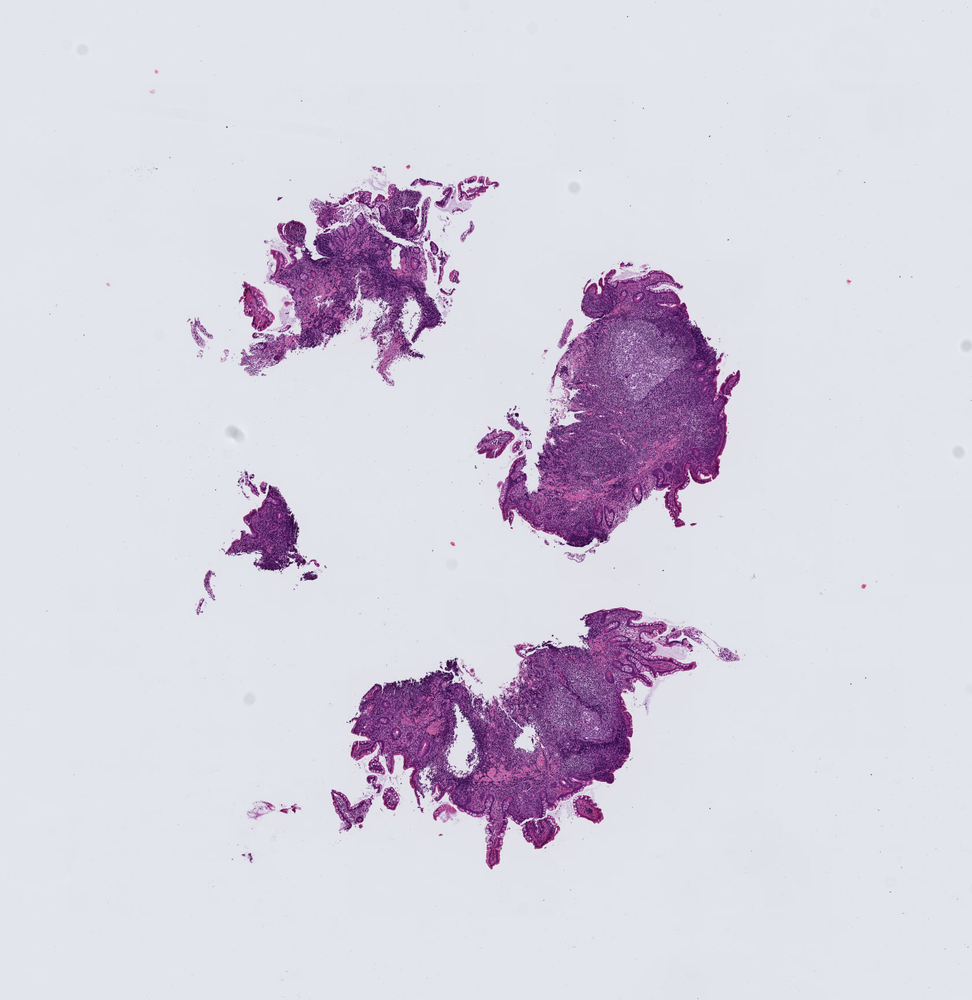

In [72]:
image = open_slide(filename)
image.get_thumbnail((1000, 1000))
# image.save("/project/GutIntelligenceLab/bwl3xy/inova1.jpg")

In [ ]:
inds = [4,8,154,137,69]


In [73]:
print(image.dimensions[0], image.dimensions[1])

26880 27648


/tmp/ipykernel_21516/3598294529.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  rgb = rgb.astype(np.int)


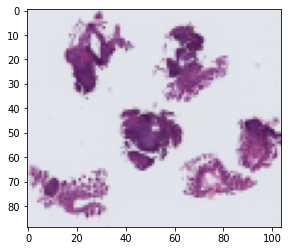

In [38]:
# Function for finding boundary

x_min, x_max, y_min, y_max = find_boundary(image)

ws = image.read_region((0, 0), image.level_count-1, image.level_dimensions[image.level_count-1])
ws = ws.convert('RGB')
ws = np.asarray(ws)
# ws = filter_grays(ws)

plt.imshow(ws[y_min:y_max, x_min:x_max])

/tmp/ipykernel_21516/3598294529.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  rgb = rgb.astype(np.int)


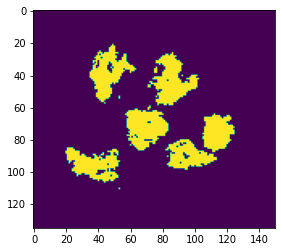

In [39]:
# Use Filter Gray to identify tissue area
ws_mask = filter_grays(ws)
plt.imshow(ws_mask)

In [12]:
print(filename)
#patch_image(filename)

/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0009D_000.svs


In [13]:
# Recommendation - Unwrap patch image function and understand it

In [14]:
for f in np.arange(len(os.listdir(PATH))):
    image_filename = PATH + os.listdir(PATH)[f]
    print(image_filename)

/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0009D_000.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0024D.ndpi
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0020D.ndpi
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0006E_001.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0008E_003.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0009D_002.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0001D_001.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0019E.ndpi
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0003E_002.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0015E_001.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0012E_000.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/INCT0012E_003.svs
/project/GutIntelligenceLab/msds/data/INOVA/unpat

In [15]:
PATH

'/project/GutIntelligenceLab/msds/data/INOVA/unpatched/Control/'

In [ ]:
for f in np.arange(len(os.listdir(PATH))):
    image_filename = PATH + os.listdir(PATH)[f]
    patch_image(image_filename)

/project/GutIntelligenceLab/msds/data/Cincinnati/patched/Control/RK10368__15872_19200.jpg


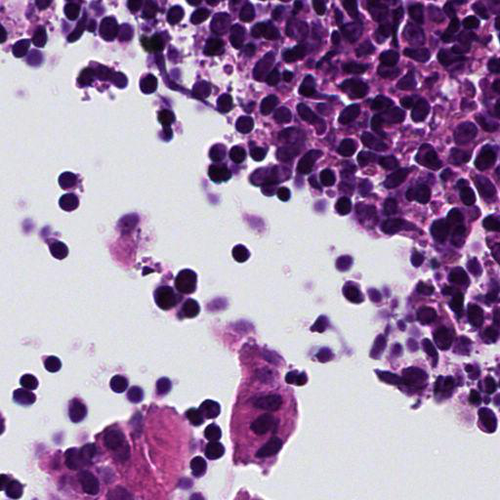

In [75]:
label = 'RK10366'

path = '/project/GutIntelligenceLab/msds/data/Cincinnati/patched/Control/'
image_patches = [i for i in os.listdir(path) if 'RK10368' in i]
filename = path+image_patches[2]
image = open_slide(filename)
print(filename)
image.get_thumbnail((500, 500))

# Display for paper

In [81]:
ind = random.randint(0, len(os.listdir(PATH)))
wsi_filename = PATH + os.listdir(PATH)[ind]
wsi_filename

'/project/GutIntelligenceLab/msds/data/Cincinnati/unpatched/Control/RK10370.ndpi'

In [82]:
patient_label = 'RK10370'

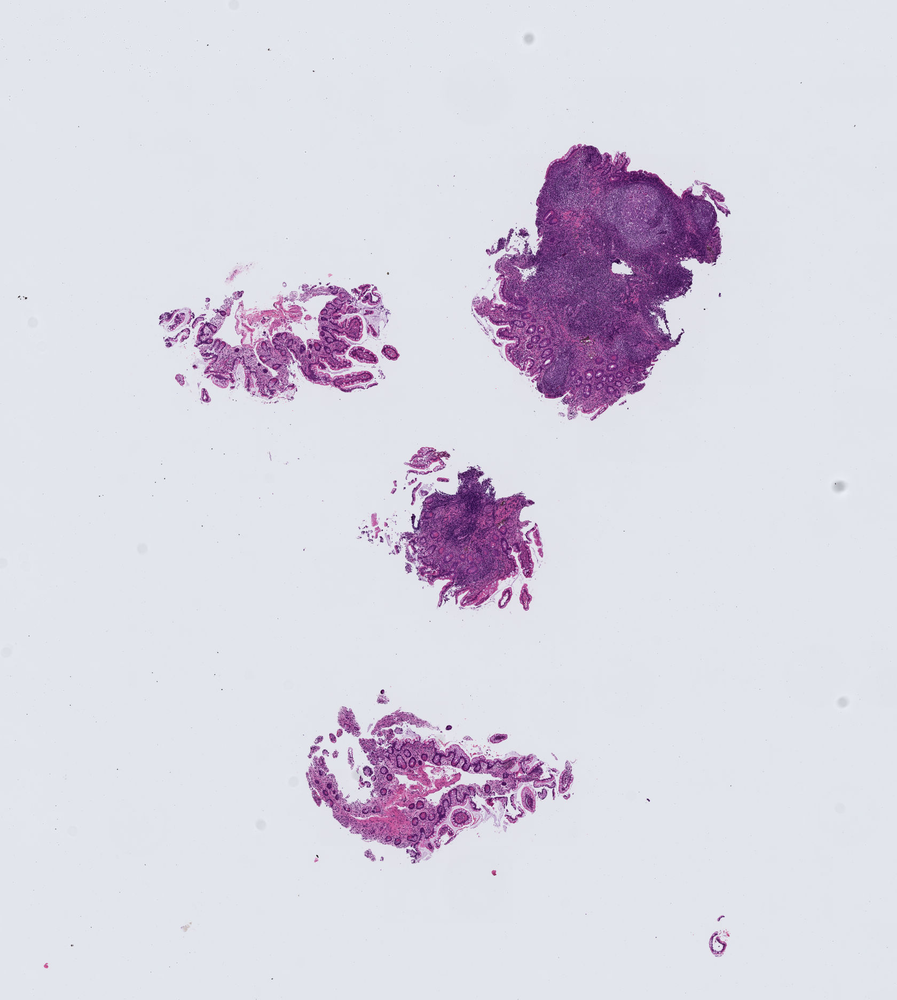

In [84]:
wsi_image = open_slide(wsi_filename)
wsi_image.get_thumbnail((1000, 1000))
# image.save("/project/GutIntelligenceLab/bwl3xy/inova1.jpg")

/tmp/ipykernel_21516/3598294529.py:12: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  rgb = rgb.astype(np.int)


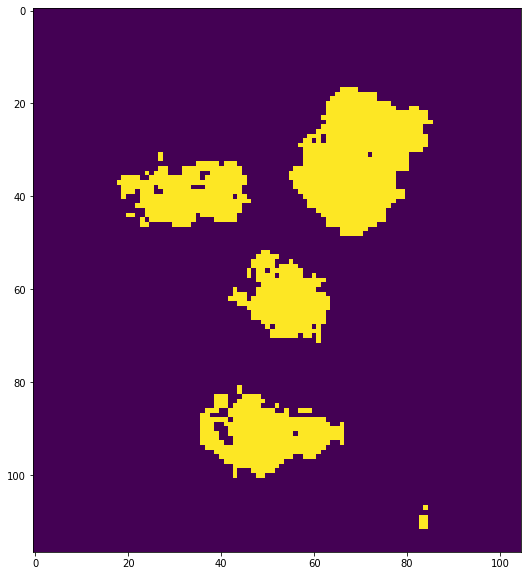

In [106]:
x_min, x_max, y_min, y_max = find_boundary(wsi_image)

ws = wsi_image.read_region((0, 0), wsi_image.level_count-1, wsi_image.level_dimensions[wsi_image.level_count-1])
ws = ws.convert('RGB')
ws = np.asarray(ws)
# ws = filter_grays(ws)

# plt.imshow(ws[y_min:y_max, x_min:x_max])

ws_mask = filter_grays(ws)
plt.figure(figsize=(10,10))
plt.imshow(ws_mask)

In [85]:
print(wsi_image.dimensions[0], wsi_image.dimensions[1])

26880 29952


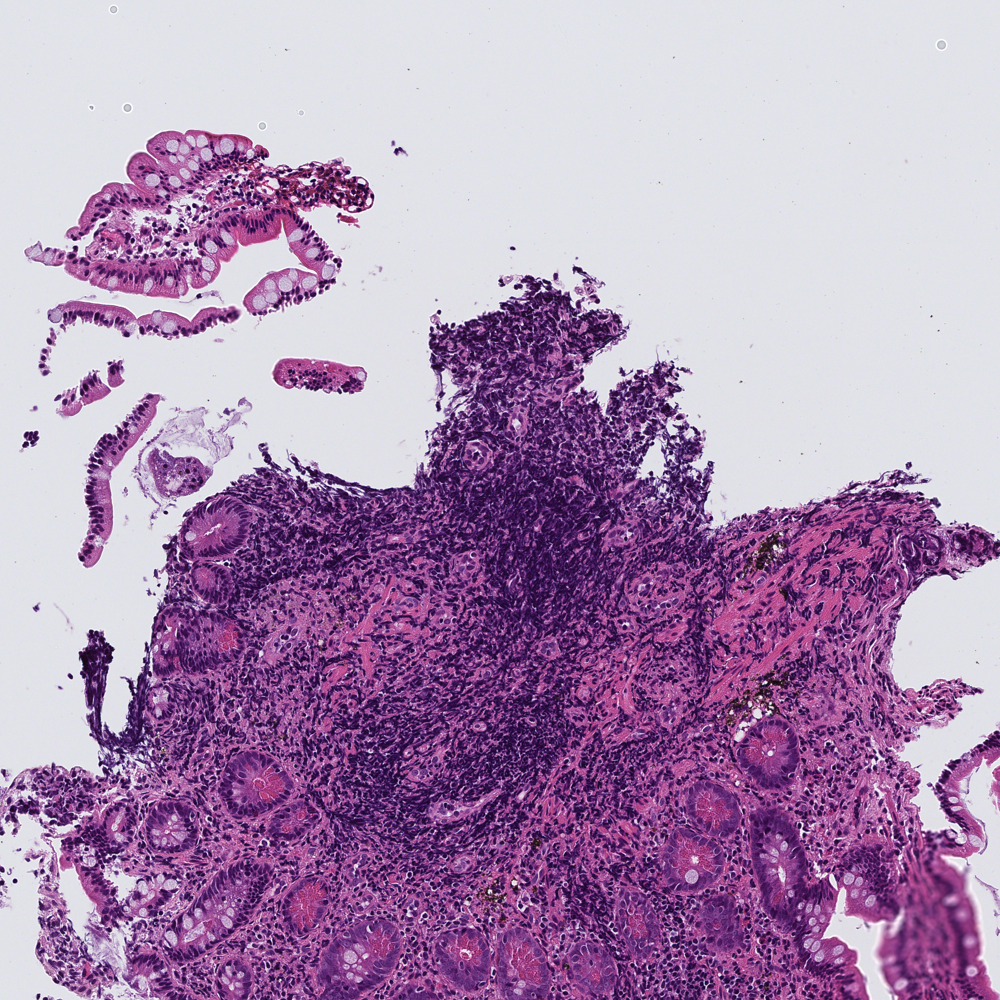

In [93]:
wsi_image.read_region(location=(12000,12868), level=0, size=(4000,4000))

In [87]:
label = 'RK10366'

path = '/project/GutIntelligenceLab/msds/data/Cincinnati/patched/Control/'
image_patches = [i for i in os.listdir(path) if patient_label in i]
image_patches

['RK10370__17920_11520.jpg',
 'RK10370__10240_9984.jpg',
 'RK10370__12800_13568.jpg',
 'RK10370__16896_6400.jpg',
 'RK10370__14848_9472.jpg',
 'RK10370__20992_6912.jpg',
 'RK10370__17408_4864.jpg',
 'RK10370__13312_24320.jpg',
 'RK10370__17408_7424.jpg',
 'RK10370__14848_17152.jpg',
 'RK10370__18432_5888.jpg',
 'RK10370__19456_9472.jpg',
 'RK10370__7168_9472.jpg',
 'RK10370__16896_8960.jpg',
 'RK10370__6144_11008.jpg',
 'RK10370__17920_8960.jpg',
 'RK10370__12288_23296.jpg',
 'RK10370__18432_9472.jpg',
 'RK10370__11264_24320.jpg',
 'RK10370__15360_8960.jpg',
 'RK10370__16896_11008.jpg',
 'RK10370__15360_15104.jpg',
 'RK10370__8192_11008.jpg',
 'RK10370__18432_8960.jpg',
 'RK10370__14336_23808.jpg',
 'RK10370__6144_9984.jpg',
 'RK10370__9728_8448.jpg',
 'RK10370__12288_23808.jpg',
 'RK10370__17408_11520.jpg',
 'RK10370__11776_24320.jpg',
 'RK10370__17920_5888.jpg',
 'RK10370__15360_15616.jpg',
 'RK10370__15360_14592.jpg',
 'RK10370__20992_7424.jpg',
 'RK10370__18944_8448.jpg',
 'RK10370

/project/GutIntelligenceLab/msds/data/Cincinnati/patched/Control/RK10370__12800_13568.jpg


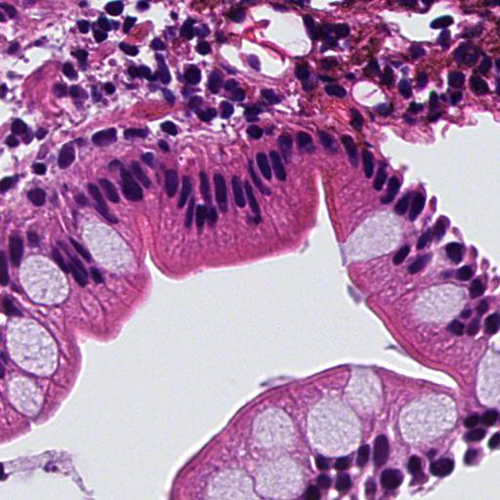

In [96]:
filename = path+image_patches[2]
image = open_slide(filename)
print(filename)
image.get_thumbnail((500, 500))

In [100]:
[i for i in image_patches if '13312' in i]

['RK10370__13312_24320.jpg',
 'RK10370__13312_22272.jpg',
 'RK10370__13312_16128.jpg',
 'RK10370__13312_14592.jpg',
 'RK10370__13312_17152.jpg',
 'RK10370__13312_16640.jpg',
 'RK10370__13312_23296.jpg',
 'RK10370__13312_15616.jpg',
 'RK10370__13312_23808.jpg',
 'RK10370__13312_22784.jpg',
 'RK10370__13312_15104.jpg']

/project/GutIntelligenceLab/msds/data/Cincinnati/patched/Control/RK10370__20992_6912.jpg


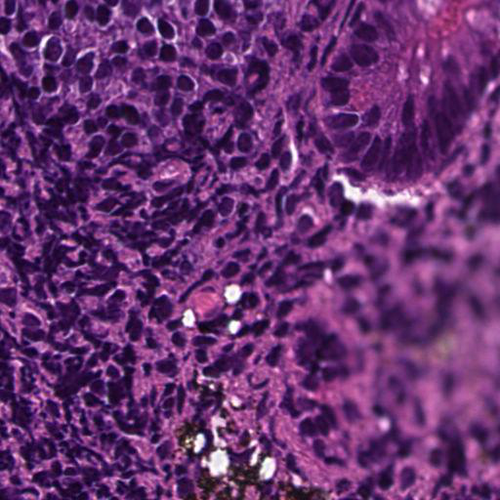

In [107]:
filename = path+image_patches[5]
image = open_slide(filename)
print(filename)
image.get_thumbnail((500, 500))

In [111]:
norm_path = '/project/GutIntelligenceLab/jyw5hw/data/combined/train/Crohns/'
norm_patches = os.listdir(norm_path)
[i for i in norm_patches if 'RK10370' in i]

[]

In [ ]:
import os
import staintools
import cv2



target = staintools.read_image("/project/GutIntelligenceLab/jyw5hw/data/combined/train/Crohns/RK10370__20992_6912.jpg")
PATH = '/project/GutIntelligenceLab/jyw5hw/data/combined/val/Control'
total = len(os.listdir(PATH))
count = 0
for filename in os.listdir(PATH):
    os.chdir('/project/GutIntelligenceLab/jyw5hw/data/combined/val/Control')
    to_transform = staintools.read_image(filename)
    target = staintools.LuminosityStandardizer.standardize(target)
    to_transform = staintools.LuminosityStandardizer.standardize(to_transform)
    normalizer = staintools.StainNormalizer(method='vahadane')
    normalizer.fit(target)
    transformed = normalizer.transform(to_transform)
    os.chdir('/project/GutIntelligenceLab/jyw5hw/data/transformed/val/Control')
    cv2.imwrite(filename, transformed)
    count += 1
    if (count % 1000 == 0):
        print(3 + (count/total) * 100)